<a href="https://colab.research.google.com/github/Letycia-Locha/7days-python-dados/blob/main/analise_completa.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Desafio 7 day of code - Python Pandas - Alura

## O que será feito?
###Nesse desafio será realizado a Análise de Dados exploratória dos dados de empréstimos dos acervos do sistema de bibliotecas da UFRN.

##O objetivo:
###Treinar minhas habilidades de manipulação, visualização e análise de dados utilizando Python Pandas.


#Dia 1

###Importação, cocatenação e limpeza de dados

In [2]:
import os

# Monta o caminho para salvar os arquivos
path = '/content/drive/MyDrive/ADE_bbt/dados_emprestimos'
os.makedirs(path, exist_ok=True)

# Lista correta de sufixos
sufixos = [
    '20101', '20102', '20111', '20112', '20121', '20122',
    '20131', '20132', '20141', '20142', '20151', '20152',
    '20161', '20162', '20171', '20172', '20181', '20182',
    '20191', '20192', '20201'
]

# Baixa cada arquivo com base no nome correto
base_url = 'https://raw.githubusercontent.com/FranciscoFoz/7_Days_of_Code_Alura-Python-Pandas/main/Dia_1-Importando_dados/Datasets/dados_emprestimos/'

for sufixo in sufixos:
    nome_arquivo = f"emprestimos-{sufixo}.csv"
    url = base_url + nome_arquivo
    destino = os.path.join(path, nome_arquivo)
    !wget -q "{url}" -O "{destino}"

print("Download concluído com sucesso.")

Download concluído com sucesso.


In [3]:
# Caminho de destino
destino_exemplares = '/content/drive/MyDrive/ADE_bbt/dados_exemplares.parquet'

# Baixar o arquivo com wget
!wget -q "https://raw.githubusercontent.com/FranciscoFoz/7_Days_of_Code_Alura-Python-Pandas/main/Dia_1-Importando_dados/Datasets/dados_exemplares.parquet" -O "{destino_exemplares}"

print("Arquivo 'dados_exemplares.parquet' baixado com sucesso.")

Arquivo 'dados_exemplares.parquet' baixado com sucesso.


In [4]:
import pandas as pd

In [46]:
from google.colab import drive
drive.mount('/content/drive')

import pandas as pd
import os

# Caminho dos arquivos
caminho = '/content/drive/MyDrive/ADE_bbt/dados_emprestimos'

# Mapear os sufixos dos arquivos
sufixos = [
    '20101', '20102', '20111', '20112', '20121', '20122',
    '20131', '20132', '20141', '20142', '20151', '20152',
    '20161', '20162', '20171', '20172', '20181', '20182',
    '20191', '20192', '20201'
]

# Criar variáveis dinamicamente usando globals()
for sufixo in sufixos:
    nome_variavel = f'dados_{sufixo}'
    caminho_arquivo = os.path.join(caminho, f'emprestimos-{sufixo}.csv')
    globals()[nome_variavel] = pd.read_csv(caminho_arquivo, sep=',', encoding='utf-8')
    print(f" {nome_variavel} carregado com {globals()[nome_variavel].shape[0]} linhas.")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
 dados_20101 carregado com 95357 linhas.
 dados_20102 carregado com 100696 linhas.
 dados_20111 carregado com 108547 linhas.
 dados_20112 carregado com 120813 linhas.
 dados_20121 carregado com 132606 linhas.
 dados_20122 carregado com 117431 linhas.
 dados_20131 carregado com 135090 linhas.
 dados_20132 carregado com 124196 linhas.
 dados_20141 carregado com 113181 linhas.
 dados_20142 carregado com 122129 linhas.
 dados_20151 carregado com 126738 linhas.
 dados_20152 carregado com 98115 linhas.
 dados_20161 carregado com 118733 linhas.
 dados_20162 carregado com 107179 linhas.
 dados_20171 carregado com 118714 linhas.
 dados_20172 carregado com 110326 linhas.
 dados_20181 carregado com 107065 linhas.
 dados_20182 carregado com 95015 linhas.
 dados_20191 carregado com 95839 linhas.
 dados_20192 carregado com 83687 linhas.
 dados_20201 carregado com 26561 lin

###Concatenando os DataFrames

In [47]:
emprestimos_biblioteca = pd.concat([
    dados_20101, dados_20102, dados_20111, dados_20112, dados_20121, dados_20122,
    dados_20131, dados_20132, dados_20141, dados_20142, dados_20151, dados_20152,
    dados_20161, dados_20162, dados_20171, dados_20172, dados_20181, dados_20182,
    dados_20191, dados_20192, dados_20201
], ignore_index=True)


### Verificando Duplicatas

In [48]:
emprestimos_biblioteca.columns

Index(['id_emprestimo', 'codigo_barras', 'data_renovacao', 'data_emprestimo',
       'data_devolucao', 'matricula_ou_siape', 'tipo_vinculo_usuario'],
      dtype='object')

###Excluindo Duplicatas

In [34]:
emprestimos_biblioteca = emprestimos_biblioteca.drop_duplicates()

In [35]:
#verificando exclusão
emprestimos_biblioteca.value_counts()

,count
"id_emprestimo,codigo_barras,data_renovacao,data_emprestimo,data_devolucao,matricula_ou_siape,tipo_vinculo_usuario",
"9999996,2010091715,2017/08/28 00:33:45.446000000,2017/08/16 16:20:12.379000000,2017/09/11 20:51:02.000000000,2016010736.0,ALUNO DE GRADUAÇÃO",1
"1000000,L160350,,2011/05/19 10:46:45.486000000,2011/05/23 08:33:23.000000000,200356445.0,ALUNO DE GRADUAÇÃO",1
"10000000,2015036976,2017/08/29 20:19:14.111000000,2017/08/16 16:21:35.442000000,2017/09/27 15:04:18.000000000,2012937973.0,ALUNO DE GRADUAÇÃO",1
"10000004,2016030594,2017/08/29 20:19:14.077000000,2017/08/16 16:21:35.491000000,2017/09/27 15:04:12.000000000,2012937973.0,ALUNO DE GRADUAÇÃO",1
"10000008,L197400,2017/08/30 20:47:44.178000000,2017/08/16 16:21:40.682000000,2017/09/14 16:12:13.000000000,20160001603.0,ALUNO DE GRADUAÇÃO",1
...,...
"10000048,2013087961,2017/08/31 15:22:56.788000000,2017/08/16 16:32:54.871000000,2017/09/15 18:42:53.000000000,20170114727.0,ALUNO DE GRADUAÇÃO",1
"10000044,2013087473,,2017/08/16 16:31:58.484000000,2017/08/18 10:50:19.000000000,2013107948.0,ALUNO DE PÓS-GRADUAÇÃO",1
"10000040,2011023797,2017/09/13 18:49:58.440000000,2017/08/16 16:31:58.439000000,2017/10/18 16:03:20.000000000,2013107948.0,ALUNO DE PÓS-GRADUAÇÃO",1


In [36]:
emprestimos_biblioteca.head()

,"id_emprestimo,codigo_barras,data_renovacao,data_emprestimo,data_devolucao,matricula_ou_siape,tipo_vinculo_usuario"
0,"709684,L095049,,2010/01/04 07:44:10.721000000,..."
1,"709685,L167050,,2010/01/04 07:44:10.750000000,..."
2,"709686,2006017618,2010/01/26 08:07:01.73800000..."
3,"709687,L184117,2010/01/18 11:07:46.470000000,2..."
8,"709688,2007027500,2010/01/19 15:59:26.46400000..."


###Importando mais dados

In [37]:
dados_exemplares = pd.read_parquet('https://github.com/FranciscoFoz/7_Days_of_Code_Alura-Python-Pandas/raw/main/Dia_1-Importando_dados/Datasets/dados_exemplares.parquet')
dados_exemplares

,id_exemplar,codigo_barras,colecao,biblioteca,status_material,localizacao,registro_sistema
index,,,,,,,
0,5,L000003,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,694,1
1,4,L000002,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,688,1
2,3,L000001,Acervo Circulante,Biblioteca Central Zila Mamede,ESPECIAL,638,1
3,7,L000114,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,616,5
5,10,L000041,Acervo Circulante,Biblioteca Central Zila Mamede,ESPECIAL,657,15
...,...,...,...,...,...,...,...
568580,1353472,2021011150,Acervo Circulante,Biblioteca Setorial do Núcleo de Educação da I...,REGULAR,951,268231
568581,1353473,2019013454,Acervo Circulante,Biblioteca Central Zila Mamede,ESPECIAL,997,268233
568582,1353474,2019012811,Acervo Circulante,Biblioteca Central Zila Mamede,ESPECIAL,987,268234


###Unindo os DataFrames

In [50]:
print("Colunas de emprestimos_biblioteca:", list(emprestimos_biblioteca.columns))
print("Colunas de dados_exemplares:", list(dados_exemplares.columns))
print("\nColunas em comum:", set(emprestimos_biblioteca.columns) & set(dados_exemplares.columns))

# Verifica tipos
print("\nTipo da coluna 'codigo_barras' em emprestimos_biblioteca:", emprestimos_biblioteca['codigo_barras'].dtype)
print("Tipo da coluna 'codigo_barras' em dados_exemplares:", dados_exemplares['codigo_barras'].dtype)

# Verifica amostra
print("\nAmostra de valores:")
print("emprestimos_biblioteca['codigo_barras']:", emprestimos_biblioteca['codigo_barras'].dropna().unique()[:5])
print("dados_exemplares['codigo_barras']:", dados_exemplares['codigo_barras'].dropna().unique()[:5])

Colunas de emprestimos_biblioteca: ['id_emprestimo', 'codigo_barras', 'data_renovacao', 'data_emprestimo', 'data_devolucao', 'matricula_ou_siape', 'tipo_vinculo_usuario']
Colunas de dados_exemplares: ['id_exemplar', 'codigo_barras', 'colecao', 'biblioteca', 'status_material', 'localizacao', 'registro_sistema']

Colunas em comum: {'codigo_barras'}

Tipo da coluna 'codigo_barras' em emprestimos_biblioteca: object
Tipo da coluna 'codigo_barras' em dados_exemplares: object

Amostra de valores:
emprestimos_biblioteca['codigo_barras']: ['L095049' 'L167050' '2006017618' 'L184117' '2007027500']
dados_exemplares['codigo_barras']: ['L000003' 'L000002' 'L000001' 'L000114' 'L000041']


In [49]:
emprestimos_completo = emprestimos_biblioteca.merge(dados_exemplares)
emprestimos_completo

,id_emprestimo,codigo_barras,data_renovacao,data_emprestimo,data_devolucao,matricula_ou_siape,tipo_vinculo_usuario,id_exemplar,colecao,biblioteca,status_material,localizacao,registro_sistema
0,709684,L095049,NaN,2010/01/04 07:44:10.721000000,2010/01/05 16:26:12.662000000,2.008023e+09,ALUNO DE GRADUAÇÃO,13259,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,630,4225
1,709685,L167050,NaN,2010/01/04 07:44:10.750000000,2010/01/12 07:34:13.934000000,2.008023e+09,ALUNO DE GRADUAÇÃO,70865,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,647,25009
2,709686,2006017618,2010/01/26 08:07:01.738000000,2010/01/04 08:08:44.081000000,2010/02/25 07:36:25.800000000,2.008112e+09,ALUNO DE PÓS-GRADUAÇÃO,195347,Acervo Circulante,Biblioteca Setorial Prof. Rodolfo Helinski - E...,REGULAR,640,75019
3,709687,L184117,2010/01/18 11:07:46.470000000,2010/01/04 08:24:21.284000000,2010/02/03 08:58:45.692000000,2.007211e+08,ALUNO DE GRADUAÇÃO,131639,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,609,44494
4,709684,L095049,NaN,2010/01/04 07:44:10.721000000,2010/01/05 16:26:12.662000000,2.008023e+09,ALUNO DE GRADUAÇÃO,13259,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,630,4225
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2072553,2989086,2008047044,NaN,2020/05/05 19:51:06.059000000,2021/05/13 14:53:31.000000000,3.067431e+06,SERVIDOR TÉCNICO-ADMINISTRATIVO,256297,Acervo Circulante,Biblioteca Setorial da Faculdade de Ciências d...,REGULAR,684,110098
2072554,2989087,2008047047,NaN,2020/05/05 19:51:06.135000000,2021/05/13 14:53:38.000000000,3.067431e+06,SERVIDOR TÉCNICO-ADMINISTRATIVO,256406,Acervo Circulante,Biblioteca Setorial da Faculdade de Ciências d...,REGULAR,628,110171
2072555,2989088,2010052905,NaN,2020/05/05 19:51:06.164000000,2021/05/13 15:01:46.000000000,3.067431e+06,SERVIDOR TÉCNICO-ADMINISTRATIVO,807821,Acervo Circulante,Biblioteca Setorial da Faculdade de Ciências d...,REGULAR,653,134173
2072556,2989089,2010048023,NaN,2020/06/09 11:54:02.669000000,2021/07/21 15:33:55.000000000,2.020101e+10,ALUNO DE PÓS-GRADUAÇÃO,804885,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,675,67712


####Unificação dos dados

#Dia 2

####Criando uma nova coluna com os valores da localização, para refletir a respectiva classe geral na CDU

In [51]:
import pandas as pd

In [52]:
emprestimos_completo.head()

,id_emprestimo,codigo_barras,data_renovacao,data_emprestimo,data_devolucao,matricula_ou_siape,tipo_vinculo_usuario,id_exemplar,colecao,biblioteca,status_material,localizacao,registro_sistema
0,709684,L095049,NaN,2010/01/04 07:44:10.721000000,2010/01/05 16:26:12.662000000,2.008023e+09,ALUNO DE GRADUAÇÃO,13259,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,630,4225
1,709685,L167050,NaN,2010/01/04 07:44:10.750000000,2010/01/12 07:34:13.934000000,2.008023e+09,ALUNO DE GRADUAÇÃO,70865,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,647,25009
2,709686,2006017618,2010/01/26 08:07:01.738000000,2010/01/04 08:08:44.081000000,2010/02/25 07:36:25.800000000,2.008112e+09,ALUNO DE PÓS-GRADUAÇÃO,195347,Acervo Circulante,Biblioteca Setorial Prof. Rodolfo Helinski - E...,REGULAR,640,75019
3,709687,L184117,2010/01/18 11:07:46.470000000,2010/01/04 08:24:21.284000000,2010/02/03 08:58:45.692000000,2.007211e+08,ALUNO DE GRADUAÇÃO,131639,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,609,44494
4,709684,L095049,NaN,2010/01/04 07:44:10.721000000,2010/01/05 16:26:12.662000000,2.008023e+09,ALUNO DE GRADUAÇÃO,13259,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,630,4225


###Atribuir a coluna com nomenclatura da CDU

In [53]:
CDU_lista = []
for CDU in emprestimos_completo['localizacao']:
  if(CDU < 100):
    CDU_lista.append('Generalidades')
  elif(CDU < 200):
    CDU_lista.append('Filosofia e psicologia')
  elif(CDU < 300):
    CDU_lista.append('Religião')
  elif(CDU < 400):
    CDU_lista.append('Ciências sociais')
  elif(CDU < 500):
    CDU_lista.append('Classe vaga')
  elif(CDU < 600):
    CDU_lista.append('Matemática e ciências naturais')
  elif(CDU < 700):
    CDU_lista.append('Ciências aplicadas')
  elif(CDU < 800):
    CDU_lista.append('Belas artes')
  elif(CDU < 900):
    CDU_lista.append('Linguagem')
  else:
    CDU_lista.append('Geografia. Biografia. História.')

emprestimos_completo['CDU_geral'] = CDU_lista

In [54]:
emprestimos_completo.head()

,id_emprestimo,codigo_barras,data_renovacao,data_emprestimo,data_devolucao,matricula_ou_siape,tipo_vinculo_usuario,id_exemplar,colecao,biblioteca,status_material,localizacao,registro_sistema,CDU_geral
0,709684,L095049,NaN,2010/01/04 07:44:10.721000000,2010/01/05 16:26:12.662000000,2.008023e+09,ALUNO DE GRADUAÇÃO,13259,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,630,4225,Ciências aplicadas
1,709685,L167050,NaN,2010/01/04 07:44:10.750000000,2010/01/12 07:34:13.934000000,2.008023e+09,ALUNO DE GRADUAÇÃO,70865,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,647,25009,Ciências aplicadas
2,709686,2006017618,2010/01/26 08:07:01.738000000,2010/01/04 08:08:44.081000000,2010/02/25 07:36:25.800000000,2.008112e+09,ALUNO DE PÓS-GRADUAÇÃO,195347,Acervo Circulante,Biblioteca Setorial Prof. Rodolfo Helinski - E...,REGULAR,640,75019,Ciências aplicadas
3,709687,L184117,2010/01/18 11:07:46.470000000,2010/01/04 08:24:21.284000000,2010/02/03 08:58:45.692000000,2.007211e+08,ALUNO DE GRADUAÇÃO,131639,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,609,44494,Ciências aplicadas
4,709684,L095049,NaN,2010/01/04 07:44:10.721000000,2010/01/05 16:26:12.662000000,2.008023e+09,ALUNO DE GRADUAÇÃO,13259,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,630,4225,Ciências aplicadas


###Excluir coluna "registro_sistema"

In [55]:
emprestimos_completo.drop(columns=['registro_sistema'],inplace=True)

###Modificar tipo de dado da matrícula

In [56]:
emprestimos_completo['matricula_ou_siape'] = emprestimos_completo['matricula_ou_siape'].astype('string')

##Dia 3

####O objetivo é entender se a quantidade de empréstimos está diminuindo, aumentando ou permanecendo igual ao decorrer dos últimos anos.
####Para isso, vamos ver qual é a quantidade total de exemplares emprestados por cada ano e plote um gráfico de linhas. E fazer uma análise em relação à visualização gerada.

In [57]:
import pandas as pd
import seaborn as sns
import matplotlib.ticker as ticker
import matplotlib.pyplot as plt

In [58]:
emprestimos_completo.head()

,id_emprestimo,codigo_barras,data_renovacao,data_emprestimo,data_devolucao,matricula_ou_siape,tipo_vinculo_usuario,id_exemplar,colecao,biblioteca,status_material,localizacao,CDU_geral
0,709684,L095049,NaN,2010/01/04 07:44:10.721000000,2010/01/05 16:26:12.662000000,2008023265.0,ALUNO DE GRADUAÇÃO,13259,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,630,Ciências aplicadas
1,709685,L167050,NaN,2010/01/04 07:44:10.750000000,2010/01/12 07:34:13.934000000,2008023265.0,ALUNO DE GRADUAÇÃO,70865,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,647,Ciências aplicadas
2,709686,2006017618,2010/01/26 08:07:01.738000000,2010/01/04 08:08:44.081000000,2010/02/25 07:36:25.800000000,2008112114.0,ALUNO DE PÓS-GRADUAÇÃO,195347,Acervo Circulante,Biblioteca Setorial Prof. Rodolfo Helinski - E...,REGULAR,640,Ciências aplicadas
3,709687,L184117,2010/01/18 11:07:46.470000000,2010/01/04 08:24:21.284000000,2010/02/03 08:58:45.692000000,200721119.0,ALUNO DE GRADUAÇÃO,131639,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,609,Ciências aplicadas
4,709684,L095049,NaN,2010/01/04 07:44:10.721000000,2010/01/05 16:26:12.662000000,2008023265.0,ALUNO DE GRADUAÇÃO,13259,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,630,Ciências aplicadas


###Verificando a relação entre empréstimo e empréstimo de exemplar

In [59]:
emprestimos_completo['id_emprestimo'].value_counts()

,count
id_emprestimo,
709705,7
709704,7
1752337,3
2422542,3
2014596,3
...,...
1523988,1
1523987,1
1523986,1


In [60]:
emprestimos_completo.loc[emprestimos_completo['id_emprestimo']==2560028]

,id_emprestimo,codigo_barras,data_renovacao,data_emprestimo,data_devolucao,matricula_ou_siape,tipo_vinculo_usuario,id_exemplar,colecao,biblioteca,status_material,localizacao,CDU_geral


In [61]:
##Quantos emprestimos foram realizados ao total?
emprestimos = len(emprestimos_completo['id_emprestimo'].drop_duplicates())
emprestimos

2068724

In [62]:
##Quantos exemplares foram emprestados ao total ?
exemplares = len(emprestimos_completo)
exemplares

2072558

In [63]:
##Quantidade de exemplares emprestadas por ano
emprestimos_data = pd.DataFrame(emprestimos_completo['data_emprestimo'].value_counts()).reset_index()
emprestimos_data.columns = ['data','quantidade']
emprestimos_data['data'] = pd.to_datetime(emprestimos_data['data'])
emprestimos_data

,data,quantidade
0,2010-01-04 09:58:46.549,7
1,2010-01-04 09:58:46.522,7
2,2017-11-06 19:52:32.782,3
3,2016-04-20 21:07:44.036,3
4,2018-11-22 18:28:01.619,3
...,...,...
2068686,2013-06-06 17:41:22.688,1
2068687,2013-06-06 17:40:06.074,1
2068688,2013-06-06 17:39:44.209,1
2068689,2013-06-06 17:34:42.071,1


In [64]:
# Extrair o ano da coluna 'data'
emprestimos_data['ano'] = emprestimos_data['data'].dt.year

# Agrupar por ano e somar as quantidades
emprestimos_por_ano = emprestimos_data.groupby('ano')['quantidade'].sum()

# Verificação
print("Quantidade total de exemplares emprestados por ano:")
print(emprestimos_por_ano)

Quantidade total de exemplares emprestados por ano:
ano
2010    161412
2011    196390
2012    221365
2013    234749
2014    219189
2015    213582
2016    215918
2017    218462
2018    194080
2019    171801
2020     25610
Name: quantidade, dtype: int64


##Configurando o tema dos gráficos

In [65]:
sns.set_theme(context='notebook',
              style='darkgrid',
              palette='deep',
              font_scale=1.3,
              rc={"figure.figsize":(15,8)})

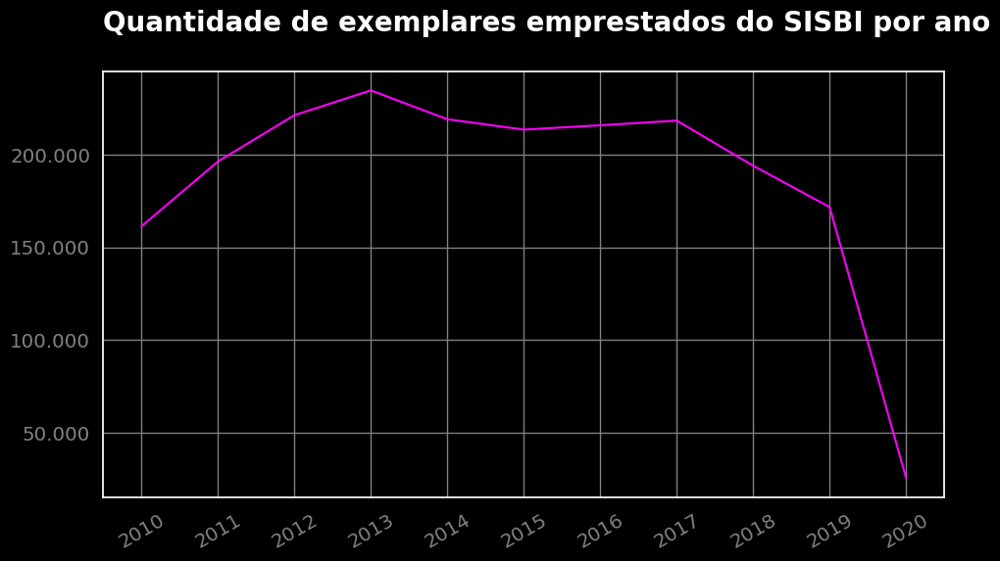

In [66]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

# Converter a Series para DataFrame
df_plot = emprestimos_por_ano.reset_index()
df_plot.columns = ['ano', 'quantidade']

# Criar o gráfico
plt.style.use('dark_background')
plt.figure(figsize=(10,6))
ax = sns.lineplot(data=df_plot, x='ano', y='quantidade', color='#FF00FF')

# Ajustes visuais
ax.set(xlabel=None, ylabel=None)
ax.set_xticks(df_plot['ano'].unique())
ax.tick_params(axis='x', rotation=30, colors='gray')
ax.tick_params(axis='y', colors='gray')
ax.grid(color='gray')
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format(int(x), ',').replace(',','.')))
ax.title.set_color('gray')
ax.set_title('Quantidade de exemplares emprestados do SISBI por ano\n', size=20, loc='left', weight='bold')

plt.tight_layout()
plt.show()

Pode-ser perceber que desde 2013 os números de exemplares emprestados diminuindo, com uma queda bem grande em 2019.

O ano de 2020 não pode ser avaliado igual, devido ao período da quantidade de dados.

É importante a direção da biblioteca investigar o que está ocorrendo desde 2013 com os procedimentos realizados. Alguns questionamentos importantes que deve-se levar a direção, para que seja aprofundada em outra análise:

* O número de alunos da universidade vem diminuindo?
* Como está a pesquisa de satisfação dos usuários da biblioteca?
* O acervo está atualizado?
* Quais são as estratégias de marketing que a biblioteca está realizando?
* O que ocorreu de diferente em 2017 em relação a 2016 e 2015 para que o número tenha se elevado?
* E em 2019?

##Quantos foram por cada mês?

In [67]:
# Extrair o mês da coluna 'data'
emprestimos_data['mês'] = emprestimos_data['data'].dt.month

# Agrupar por mês e somar as quantidades
emprestimos_por_mes = emprestimos_data.groupby('mês')['quantidade'].sum()

# Verificação
print("Quantidade total de exemplares emprestados por mês:")
print(emprestimos_por_mes)

Quantidade total de exemplares emprestados por mês:
mês
1      67542
2     210200
3     252185
4     208725
5     202530
6     138131
7     123790
8     232793
9     208234
10    188410
11    164222
12     75796
Name: quantidade, dtype: int64


###Trocando os números pelos nomes dos meses

In [68]:
dicionario_meses = {1:'Jan',2:'Fev',3:'Mar',4:'Abr',
                    5:'Mai',6:'Jun',7:'Jul',8:'Ago',
                    9:'Set',10:'Out',11:'Nov',12:'Dez'}

In [69]:
emprestimos_por_mes.index = emprestimos_por_mes.index.map(dicionario_meses)

In [70]:
emprestimos_por_mes

,quantidade
mês,
Jan,67542
Fev,210200
Mar,252185
Abr,208725
Mai,202530
Jun,138131
Jul,123790
Ago,232793
Set,208234


In [71]:
# Converter para datetime se necessário
emprestimos_completo['data_emprestimo'] = pd.to_datetime(emprestimos_completo['data_emprestimo'], errors='coerce')

# Criar coluna com nome do mês (abreviado) e número do mês para ordenação
emprestimos_completo['mes_num'] = emprestimos_completo['data_emprestimo'].dt.month
emprestimos_completo['mes_nome'] = emprestimos_completo['data_emprestimo'].dt.strftime('%b')  # Jan, Fev, etc.

# Agrupar e somar a quantidade de empréstimos por mês (todos os anos somados)
emprestimos_por_mes = emprestimos_completo.groupby(['mes_num', 'mes_nome']).size().reset_index(name='quantidade')

# Ordenar corretamente os meses
emprestimos_por_mes = emprestimos_por_mes.sort_values('mes_num')

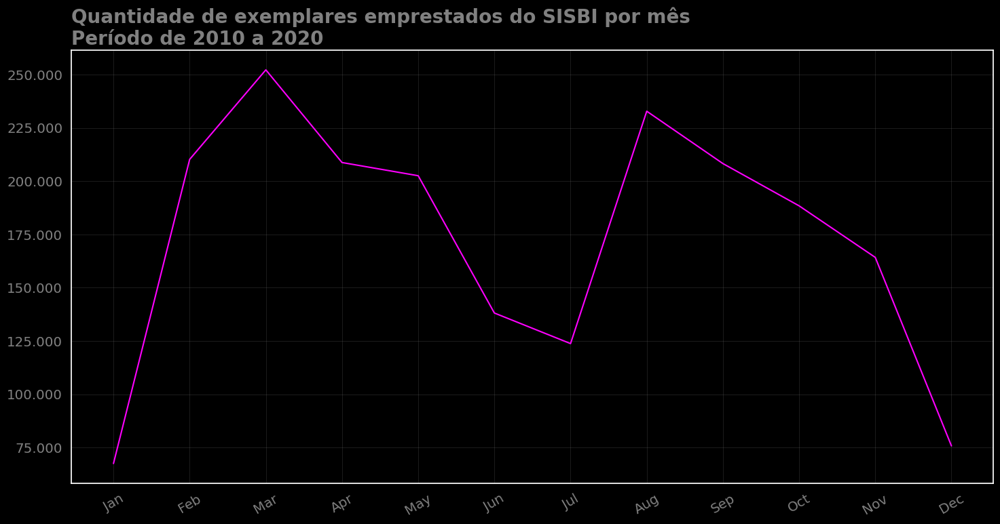

In [72]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

# Estilo escuro
plt.style.use('dark_background')

# Gráfico com linha rosa choque
plt.figure(figsize=(15,8))
ax = sns.lineplot(data=emprestimos_por_mes, x='mes_nome', y='quantidade', color='#FF00FF')

# Aparência
ax.set(xlabel=None, ylabel=None)
ax.tick_params(axis='x', colors='gray', labelrotation=30)
ax.tick_params(axis='y', colors='gray')
ax.grid(color='gray', linestyle='-', linewidth=0.5, alpha=0.3)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format(int(x), ',').replace(',','.')))

# Título e legenda
ax.set_title("Quantidade de exemplares emprestados do SISBI por mês\nPeríodo de 2010 a 2020",
             size=20, loc='left', weight='bold', color='gray')

plt.tight_layout()
plt.show()

Pode-se visualizar que os meses com maiores números de exemplares emprestados foram em março e agosto.

Por ser uma biblioteca universitária meses de férias como janeiro, julho e dezembro são os menores números.

O que não é nada de novo, entretanto caso todos os colaboradores saírem de férias durante esse período não conseguiríamos manter todo o funcionamento da biblioteca.

Principalmente com atividades de inventário que podem ocorrer anualmente ou de dois em dois anos e o melhor período seria de dezembro a janeiro.

Então meses como maio, junho, outubro e novembro podem ser uma opção a ser considerada pela direção da biblioteca.

Nota-se também a grande queda no mês de junho. Cabe aqui um alerta para se investigar mais, o que está ocorrendo e desenvolver estratégias e ações de marketing da biblioteca para que se aumente o número de exemplares emprestados.

Como por exemplo: uma ação para que sejam realizados empréstimos de livros para a leitura nas férias de julho.

###Qual é a quantidade de empréstimos por hora ao longo do dia?

In [73]:
emprestimos_data.data

,data
0,2010-01-04 09:58:46.549
1,2010-01-04 09:58:46.522
2,2017-11-06 19:52:32.782
3,2016-04-20 21:07:44.036
4,2018-11-22 18:28:01.619
...,...
2068686,2013-06-06 17:41:22.688
2068687,2013-06-06 17:40:06.074
2068688,2013-06-06 17:39:44.209
2068689,2013-06-06 17:34:42.071


In [74]:
# Agrupar e contar a quantidade de empréstimos por hora do dia
emprestimos_por_hora = emprestimos_data.groupby(emprestimos_data['data'].dt.hour).size()

# Organizar em DataFrame
emprestimos_por_hora.index.name = 'hora'
emprestimos_por_hora.name = 'quantidade'
emprestimos_por_hora = emprestimos_por_hora.reset_index()

# Ver resultado
emprestimos_por_hora

,hora,quantidade
0,0,17
1,6,14
2,7,18735
3,8,103226
4,9,131032
5,10,185457
6,11,179713
7,12,148459
8,13,126756
9,14,150571


In [75]:
emprestimos_por_hora = emprestimos_por_hora.sort_values(ascending=True,by='quantidade')

In [76]:
emprestimos_por_hora.index.name = 'hora'

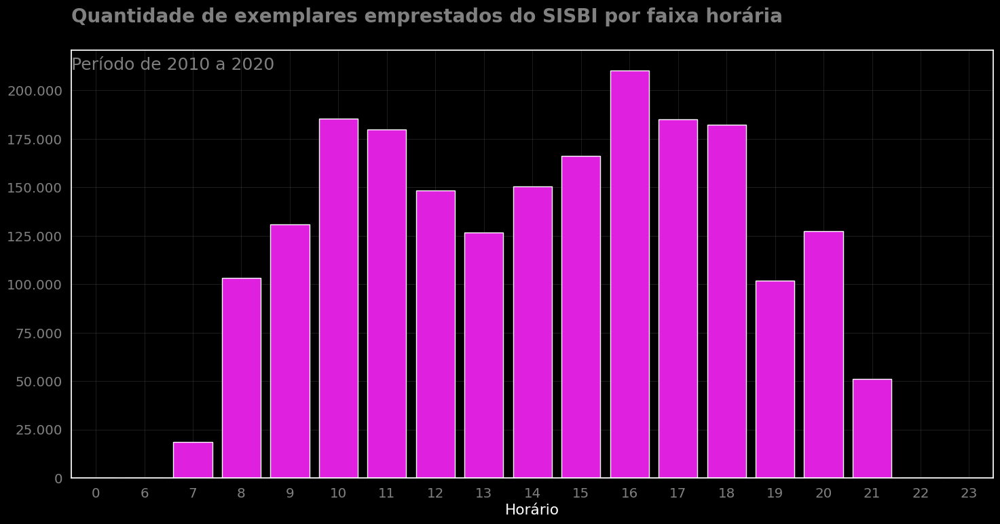

In [77]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

plt.style.use('dark_background')

# Gráfico de barras com eixo X correto
plt.figure(figsize=(15,8))
ax = sns.barplot(data=emprestimos_por_hora, x='hora', y='quantidade', color='#FF00FF')

# Ajustes visuais
ax.set(xlabel='Horário', ylabel=None)
ax.tick_params(axis='x', colors='gray')
ax.tick_params(axis='y', colors='gray')
ax.grid(color='gray', linestyle='-', linewidth=0.5, alpha=0.3)
ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format(int(x), ',').replace(',','.')))

# Título e anotação
ax.set_title("Quantidade de exemplares emprestados do SISBI por faixa horária\n",
             size=20, loc='left', weight='bold', color='gray')
ax.text(s='Período de 2010 a 2020', x=-0.5, y=emprestimos_por_hora['quantidade'].max() + 500,
        fontsize=18, ha='left', color='gray')

plt.tight_layout()
plt.show()

Através do gráfico é possível identificar que os períodos das 10 h e 16 h são os de maior pico no atendimento de empréstimos.

Períodos do começo da manhã (entre 7h e 9) e da noite (entre 19h e 22) podem ser os melhores horários para que se realizem as demais atividades além do atendimento.

##Dia 4

In [78]:
import pandas as pd

emprestimos_completo.head()

,id_emprestimo,codigo_barras,data_renovacao,data_emprestimo,data_devolucao,matricula_ou_siape,tipo_vinculo_usuario,id_exemplar,colecao,biblioteca,status_material,localizacao,CDU_geral,mes_num,mes_nome
0,709684,L095049,NaN,2010-01-04 07:44:10.721,2010/01/05 16:26:12.662000000,2008023265.0,ALUNO DE GRADUAÇÃO,13259,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,630,Ciências aplicadas,1,Jan
1,709685,L167050,NaN,2010-01-04 07:44:10.750,2010/01/12 07:34:13.934000000,2008023265.0,ALUNO DE GRADUAÇÃO,70865,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,647,Ciências aplicadas,1,Jan
2,709686,2006017618,2010/01/26 08:07:01.738000000,2010-01-04 08:08:44.081,2010/02/25 07:36:25.800000000,2008112114.0,ALUNO DE PÓS-GRADUAÇÃO,195347,Acervo Circulante,Biblioteca Setorial Prof. Rodolfo Helinski - E...,REGULAR,640,Ciências aplicadas,1,Jan
3,709687,L184117,2010/01/18 11:07:46.470000000,2010-01-04 08:24:21.284,2010/02/03 08:58:45.692000000,200721119.0,ALUNO DE GRADUAÇÃO,131639,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,609,Ciências aplicadas,1,Jan
4,709684,L095049,NaN,2010-01-04 07:44:10.721,2010/01/05 16:26:12.662000000,2008023265.0,ALUNO DE GRADUAÇÃO,13259,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,630,Ciências aplicadas,1,Jan


###Modificando tipo de dado da data de empréstimo do DataFrame

In [79]:
emprestimos_completo['data_emprestimo'] = pd.to_datetime(emprestimos_completo['data_emprestimo'])

##Verificando valores únicos das variáveis

In [80]:
emprestimos_completo.tipo_vinculo_usuario.unique()

array(['ALUNO DE GRADUAÇÃO', 'ALUNO DE PÓS-GRADUAÇÃO', 'DOCENTE',
       'SERVIDOR TÉCNICO-ADMINISTRATIVO', 'DOCENTE EXTERNO',
       'ALUNO MÉDIO/TÉCNICO', 'USUÁRIO EXTERNO', 'OUTROS'], dtype=object)

In [81]:
emprestimos_completo.colecao.unique()

array(['Acervo Circulante', 'Folhetos', 'Teses', 'Dissertações',
       'Monografias', 'Publicações de Autores do RN',
       'Publicações da UFRN', 'Multimeios', 'Coleção Mossoroense',
       'Eventos', 'Trabalho Acadêmico', 'Obras de Referência',
       'Obras Raras', 'Literatura de Cordel', 'Coleção Zila Mamede',
       'Necessidades Educacionais Específicas'], dtype=object)

In [82]:
emprestimos_completo.biblioteca.unique()


array(['Biblioteca Central Zila Mamede',
       'Biblioteca Setorial Prof. Rodolfo Helinski - Escola Agrícola de Jundiaí - EAJ  - Macaiba',
       'Biblioteca Setorial Bertha Cruz Enders - \xadEscola de Saúde da UFRN - ESUFRN',
       'Biblioteca Setorial do Centro Ciências da Saúde - CCS',
       'Biblioteca Setorial Prof. Alberto Moreira Campos - \xadDepartamento de Odontologia',
       'Biblioteca Setorial Prof. Ronaldo Xavier de Arruda - CCET',
       'Biblioteca Setorial do Centro de Ciências Humanas, Letras e Artes - CCHLA',
       'Biblioteca Setorial Prof. Horácio Nicolas Solimo - \xad Engenharia Química - EQ - CT',
       'Biblioteca Setorial Prof. Francisco Gurgel De Azevedo - Instituto Química - IQ',
       'Biblioteca Setorial do Centro Ciências Sociais Aplicadas - CCSA',
       'Biblioteca Setorial do Departamento de Artes - DEART',
       'Biblioteca Setorial Prof. Dr. Marcelo Bezerra de Melo Tinôco - DARQ - \xadCT',
       'Biblioteca Setorial Árvore do Conhecimento - In

In [83]:
emprestimos_completo.CDU_geral.unique()

array(['Ciências aplicadas', 'Linguagem', 'Ciências sociais',
       'Geografia. Biografia. História.',
       'Matemática e ciências naturais', 'Religião', 'Generalidades',
       'Filosofia e psicologia', 'Belas artes'], dtype=object)

###Função

In [84]:
def tabela_frequencia(variavel):
  '''
  Esta função irá gerar uma tabela de frequência com percentuais de acordo
  com a variável passada.

  variavel = variável categórica escolhida de dentro do conjunto de dados
  emprestimos_completo
  '''

  dataframe = pd.DataFrame(emprestimos_completo[variavel].value_counts())
  dataframe.columns = ['quantidade']
  dataframe['percentual'] = round((dataframe.quantidade / dataframe.quantidade.sum())*100,1)

  return dataframe

##Número de empréstimos de acordo com o tipo de vínculo do usuário

In [85]:
tabela_frequencia('tipo_vinculo_usuario')

,quantidade,percentual
tipo_vinculo_usuario,,
ALUNO DE GRADUAÇÃO,1612351,77.8
ALUNO DE PÓS-GRADUAÇÃO,302547,14.6
DOCENTE,70981,3.4
SERVIDOR TÉCNICO-ADMINISTRATIVO,32184,1.6
ALUNO MÉDIO/TÉCNICO,28032,1.4
DOCENTE EXTERNO,23949,1.2
USUÁRIO EXTERNO,2509,0.1
OUTROS,5,0.0


O maior público da biblioteca são de fato os alunos de graduação com aproxidamente 78% o segundo maior público é o de pós graduação com aproximadamente 15%.

Vale lembrar que esta é apenas uma métrica geral a partir dos exemplares emprestados.

Possilvemente a maior diferença entre os percentuais dos dois anteriores é devido a dois pontos:

* Alunos de pós graduação, tem o maior enfoque em artigos científicos que são acessados através de bases de dados bibliográficas.
* A maior quantidade de alunos de graduação em comparação com os da pós na universidade.

##Quantos foram por coleção?

In [86]:
tabela_frequencia('colecao')

,quantidade,percentual
colecao,,
Acervo Circulante,2053156,99.1
Multimeios,7954,0.4
Monografias,4021,0.2
Dissertações,2406,0.1
Obras de Referência,1954,0.1
Publicações de Autores do RN,866,0.0
Publicações da UFRN,764,0.0
Teses,714,0.0
Folhetos,271,0.0


A principal coleção é a própria circulante o que se cria um alerta, pois está com 99% de todos os exemplares empréstados.

Principalmente para as monografias, dissertações e teses que poderiam estar sendo mais consultadas para que haja um crescimento das discussões de pesquisa interna da instituição.

Entretanto é importante verificar se esses documentos não estão disponíveis na coleção online e por este motivo não é emprestada fisicamente.

As coleções: Coleção Mossoroense, Coleção Zila Mamede, Literatura de Cordel, Obras Raras devem ter uma atenção especial em entender a razão que estão com números tão pequenos de frequência.

##Quantos foram por biblioteca?

In [87]:
tabela_frequencia('biblioteca')

,quantidade,percentual
biblioteca,,
Biblioteca Central Zila Mamede,1426148,68.8
Biblioteca Setorial do Centro Ciências da Saúde - CCS,118616,5.7
Biblioteca Setorial da Faculdade de Ciências da Saúde do Trairi - FACISA - Santa Cruz,77609,3.7
Biblioteca Setorial Prof. Alberto Moreira Campos - ­Departamento de Odontologia,66452,3.2
Biblioteca Setorial Profª. Maria Lúcia da Costa Bezerra - ­CERES­ - Caicó,61478,3.0
Biblioteca Setorial Bertha Cruz Enders - ­Escola de Saúde da UFRN - ESUFRN,46040,2.2
"Biblioteca Setorial do Centro de Ciências Humanas, Letras e Artes - CCHLA",40746,2.0
Biblioteca Setorial Dr. Paulo Bezerra - EMCM/RN - Caicó,32097,1.5
Biblioteca Setorial Profª. Maria José Mamede Galvão - FELCS - Currais Novos,29089,1.4


Era esperado maior predominância da biblioteca central, considerando o tamanho e localização da mesma.

Este ranking é importante para se entender o contexto geral do sistema de bibliotecas, entretanto para que se enriqueça ainda mais essa análise se faz necessário uma avaliação interna de outras métricas, como:

* A quantidade esperada de empréstimos.
* Quantidade de empréstimos por usuário cadastrado em cada biblioteca.
* Ações e investimentos realizados em cada uma.

##Quantos foram pela CDU geral?

In [89]:
tabela_frequencia('CDU_geral')

,quantidade,percentual
CDU_geral,,
Ciências aplicadas,1425496,68.8
Ciências sociais,369543,17.8
Matemática e ciências naturais,68745,3.3
Generalidades,62525,3.0
Religião,62295,3.0
Filosofia e psicologia,60564,2.9
Geografia. Biografia. História.,7989,0.4
Belas artes,7911,0.4
Linguagem,7490,0.4


De maneira geral podemos observar que há uma grande diferença entre os temas.

Será importante entender a razão de materiais do tema de Geografia/Biografia/História, Belas artes e Linguagem estão com números tão baixos.

Algumas questões surgem:

* O acervo está atualizado?
* O público da biblioteca tem a necessidade destas informações? Se sim, por que não estão usando?
* Quais ações de marketing estão sendo realizadas para esses temas?

#Dia 5

###Realizando recortes nos dados, com o uso da ferramenta Boxplot, a fim de obter informações atualizadas e úteis. Os recortes visam entender melhor a distribuição dos dados ao longo dos anos.

In [97]:
import matplotlib.pyplot as plt
import seaborn as sns

# Define estilo visual personalizado
def aplicar_estilo_personalizado():
    plt.style.use('default')
    plt.rcParams.update({
        'axes.facecolor': '#000000',        # fundo do gráfico
        'figure.facecolor': '#000000',      # fundo da figura
        'axes.edgecolor': '#999999',        # borda dos eixos
        'axes.labelcolor': '#CCCCCC',       # cor dos textos dos eixos
        'xtick.color': '#CCCCCC',
        'ytick.color': '#CCCCCC',
        'text.color': '#CCCCCC',            # cor do título
        'axes.titleweight': 'bold',
        'axes.titlesize': 16,
        'axes.titlecolor': '#CCCCCC',
        'grid.color': '#666666',            # cor da grade
        'grid.alpha': 0.3,
        'legend.facecolor': '#000000',
        'legend.edgecolor': '#CCCCCC',
    })

    sns.set_palette(['#FF2ECC'])  # rosa choque como cor base dos gráficos

# Aplicar estilo
aplicar_estilo_personalizado()

In [92]:
emprestimos_completo.head()

,id_emprestimo,codigo_barras,data_renovacao,data_emprestimo,data_devolucao,matricula_ou_siape,tipo_vinculo_usuario,id_exemplar,colecao,biblioteca,status_material,localizacao,CDU_geral,mes_num,mes_nome
0,709684,L095049,NaN,2010-01-04 07:44:10.721,2010/01/05 16:26:12.662000000,2008023265.0,ALUNO DE GRADUAÇÃO,13259,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,630,Ciências aplicadas,1,Jan
1,709685,L167050,NaN,2010-01-04 07:44:10.750,2010/01/12 07:34:13.934000000,2008023265.0,ALUNO DE GRADUAÇÃO,70865,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,647,Ciências aplicadas,1,Jan
2,709686,2006017618,2010/01/26 08:07:01.738000000,2010-01-04 08:08:44.081,2010/02/25 07:36:25.800000000,2008112114.0,ALUNO DE PÓS-GRADUAÇÃO,195347,Acervo Circulante,Biblioteca Setorial Prof. Rodolfo Helinski - E...,REGULAR,640,Ciências aplicadas,1,Jan
3,709687,L184117,2010/01/18 11:07:46.470000000,2010-01-04 08:24:21.284,2010/02/03 08:58:45.692000000,200721119.0,ALUNO DE GRADUAÇÃO,131639,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,609,Ciências aplicadas,1,Jan
4,709684,L095049,NaN,2010-01-04 07:44:10.721,2010/01/05 16:26:12.662000000,2008023265.0,ALUNO DE GRADUAÇÃO,13259,Acervo Circulante,Biblioteca Central Zila Mamede,REGULAR,630,Ciências aplicadas,1,Jan


###Alunos de graduação

In [93]:
alunos_graduacao = emprestimos_completo.query('tipo_vinculo_usuario == "ALUNO DE GRADUAÇÃO"')
alunos_graduacao.colecao.value_counts()

,count
colecao,
Acervo Circulante,1600182
Multimeios,4652
Monografias,3572
Dissertações,1152
Obras de Referência,1047
Publicações de Autores do RN,595
Publicações da UFRN,466
Teses,245
Folhetos,180


###Criando uma tabela com a quantidade mensal/ano

In [94]:
alunos_graduacao_acervo_circulante = alunos_graduacao.query('colecao == "Acervo Circulante"')
alunos_graduacao_acervo_circulante = pd.DataFrame(alunos_graduacao_acervo_circulante)
alunos_graduacao_acervo_circulante['data_emprestimo'] = pd.to_datetime(alunos_graduacao_acervo_circulante['data_emprestimo'])
alunos_graduacao_acervo_circulante['ano'] = alunos_graduacao_acervo_circulante['data_emprestimo'].dt.year
alunos_graduacao_acervo_circulante['mes'] = alunos_graduacao_acervo_circulante['data_emprestimo'].dt.month
alunos_graduacao_acervo_circulante = alunos_graduacao_acervo_circulante.loc[:,['ano','mes']]
alunos_graduacao_acervo_circulante = alunos_graduacao_acervo_circulante.value_counts().to_frame('quantidade').reset_index()
alunos_graduacao_acervo_circulante

,ano,mes,quantidade
0,2012,3,22797
1,2015,3,22483
2,2013,4,21853
3,2017,3,21735
4,2016,3,21692
...,...,...,...
118,2017,1,2671
119,2019,1,2276
120,2019,12,1980
121,2020,1,1781


from matplotlib import pyplot as plt
alunos_graduacao_acervo_circulante['ano'].plot(kind='hist', bins=20, title='ano')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
alunos_graduacao_acervo_circulante['mes'].plot(kind='hist', bins=20, title='mes')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
alunos_graduacao_acervo_circulante['quantidade'].plot(kind='hist', bins=20, title='quantidade')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
alunos_graduacao_acervo_circulante.plot(kind='scatter', x='ano', y='mes', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
alunos_graduacao_acervo_circulante.plot(kind='scatter', x='mes', y='quantidade', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
alunos_graduacao_acervo_circulante['ano'].plot(kind='line', figsize=(8, 4), title='ano')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
alunos_graduacao_acervo_circulante['mes'].plot(kind='line', figsize=(8, 4), title='mes')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
alunos_graduacao_acervo_circulante['quantidade'].plot(kind='line', figsize=(8, 4), title='quantidade')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_0['index'].plot(kind='hist', bins=20, title='index')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_1['ano'].plot(kind='hist', bins=20, title='ano')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_2['mes'].plot(kind='hist', bins=20, title='mes')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_3['quantidade'].plot(kind='hist', bins=20, title='quantidade')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_4.plot(kind='scatter', x='index', y='ano', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_5.plot(kind='scatter', x='ano', y='mes', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_6.plot(kind='scatter', x='mes', y='quantidade', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['ano']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_7.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('ano')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['mes']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_8.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('mes')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['index']
  ys = series['quantidade']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_9.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('quantidade')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['index']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'index'}, axis=1)
              .sort_values('index', ascending=True))
  xs = counted['index']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_10.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
_df_11['index'].plot(kind='line', figsize=(8, 4), title='index')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_12['ano'].plot(kind='line', figsize=(8, 4), title='ano')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_13['mes'].plot(kind='line', figsize=(8, 4), title='mes')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_14['quantidade'].plot(kind='line', figsize=(8, 4), title='quantidade')
plt.gca().spines[['top', 'right']].set_visible(False)

##Função gera_box_plot

In [100]:
def gera_box_plot(dataset, x, y, titulo, subtitulo):
    '''
    Esta função irá gerar um gráfico de boxplot com estilo escuro e cor personalizada.

    dataset = conjunto de dados do gráfico
    x = valor do eixo x do gráfico
    y = valor do eixo y do gráfico
    titulo = título do gráfico
    subtitulo = subtítulo do gráfico
    '''

    # Estilo personalizado
    plt.style.use('default')
    plt.rcParams.update({
        'axes.facecolor': '#000000',
        'figure.facecolor': '#000000',
        'axes.edgecolor': '#999999',
        'axes.labelcolor': '#CCCCCC',
        'xtick.color': '#CCCCCC',
        'ytick.color': '#CCCCCC',
        'text.color': '#CCCCCC',
        'axes.titleweight': 'bold',
        'axes.titlesize': 16,
        'axes.titlecolor': '#CCCCCC',
        'grid.color': '#666666',
        'grid.alpha': 0.3,
        'legend.facecolor': '#000000',
        'legend.edgecolor': '#CCCCCC',
    })
    sns.set_palette(['#FF2ECC'])  # rosa choque
    sns.set_theme(style="darkgrid", font_scale=1.3)

    # Criação do gráfico
    plt.figure(figsize=(16,10))
    ax = sns.boxplot(y=y, x=x, data=dataset, color='#FF2ECC')

    # Formatação dos valores no eixo Y
    ax.yaxis.set_major_formatter(ticker.FuncFormatter(lambda x, p: format(int(x), ',').replace(',', '.')))

    plt.ylim(0, max(dataset[y]) * 1.1)
    plt.xlabel(None)
    plt.ylabel(None)

    ax.set_title(titulo + "\n", size=20, loc='left', weight='bold')
    ax.text(s=subtitulo, x=-0.5, y=max(dataset[y]) * 1.11, fontsize=18, ha='left', color='#CCCCCC')

###Distribuição dos empréstimos mensais realizados pelos alunos de graduação na coleção do acervo circulante

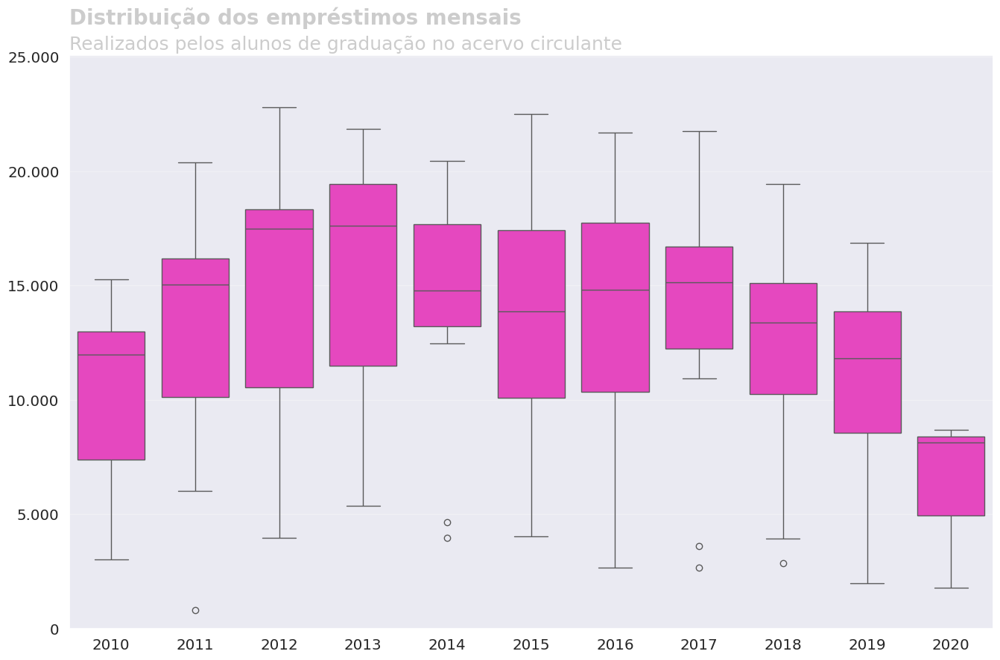

In [101]:
gera_box_plot(alunos_graduacao_acervo_circulante,'ano','quantidade','Distribuição dos empréstimos mensais', 'Realizados pelos alunos de graduação no acervo circulante')

É importante ressaltar que esse recorte, reflete grande parte da estrutura geral do conjunto de dados, pois são os tipos de usuários com maior frequência (alunos de graduação) e da coleção mais utilizada por eles (acervo circulante).

Com o boxplot é possível observar a oscilação da quantidade de empréstimos realizados mensalmente durante cada ano.

Além da análise geral realizada (declínio a partir de 2013, forte baixa em 2019), chama atenção os anos de 2014 e 2017. Que se excluíssemos os outliers (possivelmente meses de janeiro e dezembro) teríamos anos com uma quantidade constante de empréstimos mensais.

Mas se diferenciam principalmente porque em 2014 houve um declínio e em 2017 houve um aumento, em relação aos anos anteriores. Seria interessante entender com a direção das bibliotecas o que ocorreu nessas datas para que pudéssemos ter um contexto melhor da realidade do negócio.

##Alunos de pós graduação

In [102]:

alunos_pos_graduacao = emprestimos_completo.query('tipo_vinculo_usuario == "ALUNO DE PÓS-GRADUAÇÃO"')
alunos_pos_graduacao.colecao.value_counts()

,count
colecao,
Acervo Circulante,299207
Dissertações,934
Obras de Referência,700
Multimeios,559
Teses,367
Monografias,278
Publicações de Autores do RN,204
Publicações da UFRN,121
Folhetos,60


##Criando tabela com a quantidade mensal por ano

In [103]:
alunos_pos_graduacao_acervo_circulante = alunos_pos_graduacao.query('colecao == "Acervo Circulante"')
alunos_pos_graduacao_acervo_circulante = pd.DataFrame(alunos_pos_graduacao_acervo_circulante)
alunos_pos_graduacao_acervo_circulante['data_emprestimo'] = pd.to_datetime(alunos_pos_graduacao_acervo_circulante['data_emprestimo'])
alunos_pos_graduacao_acervo_circulante['ano'] = alunos_pos_graduacao_acervo_circulante['data_emprestimo'].dt.year
alunos_pos_graduacao_acervo_circulante['mes'] = alunos_pos_graduacao_acervo_circulante['data_emprestimo'].dt.month
alunos_pos_graduacao_acervo_circulante = alunos_pos_graduacao_acervo_circulante.loc[:,['ano','mes']]
alunos_pos_graduacao_acervo_circulante = alunos_pos_graduacao_acervo_circulante.value_counts().to_frame('quantidade').reset_index()
alunos_pos_graduacao_acervo_circulante

,ano,mes,quantidade
0,2015,3,3927
1,2017,8,3837
2,2017,3,3722
3,2016,3,3711
4,2016,8,3662
...,...,...,...
119,2020,1,1143
120,2010,1,1106
121,2019,12,1069
122,2011,1,465


##Distribuição dos empréstimos mensais realizados pelos alunos de pós graduação na coleção do acervo circulante

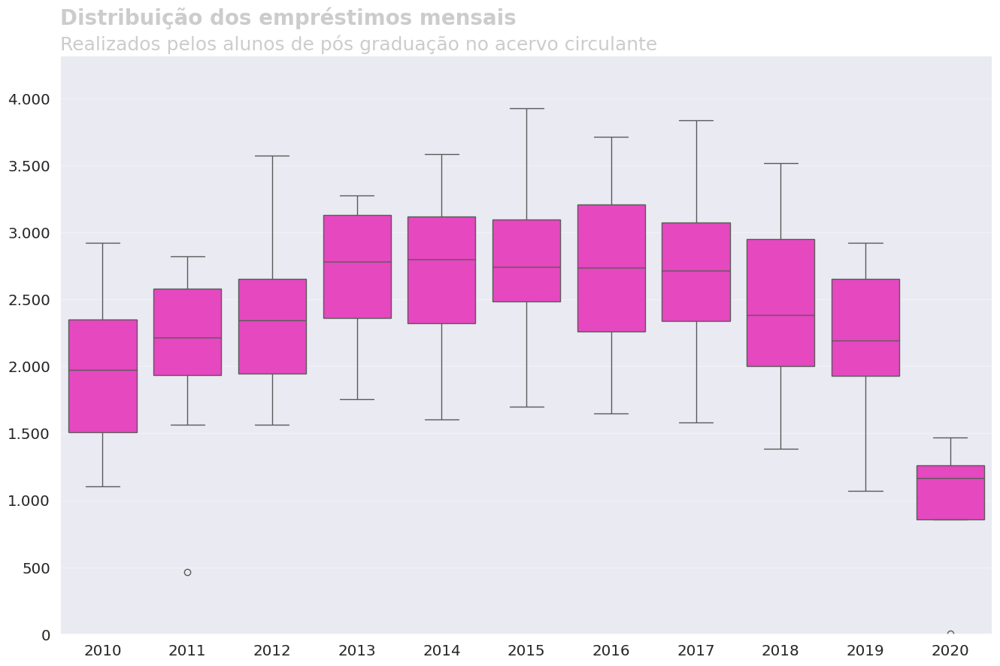

In [104]:
gera_box_plot(alunos_pos_graduacao_acervo_circulante,'ano','quantidade','Distribuição dos empréstimos mensais', 'Realizados pelos alunos de pós graduação no acervo circulante')

Já os alunos de pós graduação tiveram um aspecto diferente em relação ao declínio a partir de 2013:

* A linha mediana foi diminuindo devagar até 2018. Entretanto valores máximos foram superiores, apenas caindo de fato em 2019.

Nos dois gráficos podemos observar um grande aumento entre 2010 e 2013, o que nos leva a pensar em quais procedimentos estavam sendo realizados neste período para que houvesse esse crescimento.

Nos dois recortes visualizamos que a partir de 2018 tivemos um forte declínio e é um alerta para que a direção possa entender o que está ocorrendo.

#Dia 6

###O objetivo agora é calcular a quantidade de empréstimos realizados entre 2015 e 2020 por cada curso de graduação que passará pela avaliação do MEC.

Os cursos serão:

* Biblioteconomia
* Ciências sociais
* Comunicação social
* Direito
* Filosofia
* Pedagogia

### Extraindo os arquivos do excel fornecido

In [106]:
cadastro_usuarios_antes_2010 = pd.read_excel('https://github.com/FranciscoFoz/7_Days_of_Code_Alura-Python-Pandas/raw/main/Dia_6-Novos_dados_novas_analises/Datasets/matricula_alunos.xlsx',
                                        sheet_name='Até 2010',skiprows=1)
cadastro_usuarios_depois_2010 = pd.read_excel('https://github.com/FranciscoFoz/7_Days_of_Code_Alura-Python-Pandas/raw/main/Dia_6-Novos_dados_novas_analises/Datasets/matricula_alunos.xlsx',
                                        sheet_name='Após 2010',skiprows=1)

In [107]:
cadastro_usuarios_antes_2010

,Número da matrícula,Tipo de vinculo,Curso
0,1.900017e+08,ALUNO DE GRADUAÇÃO,MATEMÁTICA
1,1.990145e+08,ALUNO DE GRADUAÇÃO,CIÊNCIAS BIOLÓGICAS
2,1.997357e+08,ALUNO DE GRADUAÇÃO,MATEMÁTICA
3,1.998124e+08,ALUNO DE GRADUAÇÃO,LETRAS
4,1.998237e+08,ALUNO DE GRADUAÇÃO,ECOLOGIA
...,...,...,...
7721,2.009075e+09,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA
7722,2.009075e+09,ALUNO DE GRADUAÇÃO,ANÁLISE E DESENVOLVIMENTO DE SISTEMAS
7723,2.009075e+09,ALUNO DE GRADUAÇÃO,ADMINISTRAÇÃO
7724,2.009075e+09,ALUNO DE GRADUAÇÃO,MÚSICA


In [108]:
cadastro_usuarios_antes_2010.columns = ['matricula_ou_siape','tipo_vinculo_usuario','curso']

In [109]:
cadastro_usuarios_depois_2010

,Matricula,Tipo de vinculo,Cursos
0,2.010000e+09,ALUNO DE GRADUAÇÃO,DIREITO
1,2.010000e+09,ALUNO DE GRADUAÇÃO,AGRONOMIA
2,2.010001e+09,ALUNO DE GRADUAÇÃO,ENGENHARIA QUÍMICA
3,2.010003e+09,ALUNO DE GRADUAÇÃO,ENGENHARIA AMBIENTAL
4,2.010003e+09,ALUNO DE GRADUAÇÃO,GEOGRAFIA
...,...,...,...
2269,2.015012e+10,ALUNO DE GRADUAÇÃO,LETRAS
2270,2.015075e+09,ALUNO DE GRADUAÇÃO,DANÇA
2271,2.016000e+10,ALUNO DE GRADUAÇÃO,ENGENHARIA DA COMPUTAÇÃO
2272,2.017009e+10,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA


In [110]:
cadastro_usuarios_depois_2010.columns= ['matricula_ou_siape','tipo_vinculo_usuario','curso']

In [111]:
cadastro_usuarios_excel = pd.concat([cadastro_usuarios_antes_2010,cadastro_usuarios_depois_2010],ignore_index=True)
cadastro_usuarios_excel.matricula_ou_siape = cadastro_usuarios_excel.matricula_ou_siape.astype('string')
cadastro_usuarios_excel

,matricula_ou_siape,tipo_vinculo_usuario,curso
0,190001688.0,ALUNO DE GRADUAÇÃO,MATEMÁTICA
1,199014489.0,ALUNO DE GRADUAÇÃO,CIÊNCIAS BIOLÓGICAS
2,199735674.0,ALUNO DE GRADUAÇÃO,MATEMÁTICA
3,199812431.0,ALUNO DE GRADUAÇÃO,LETRAS
4,199823670.0,ALUNO DE GRADUAÇÃO,ECOLOGIA
...,...,...,...
9995,20150116770.0,ALUNO DE GRADUAÇÃO,LETRAS
9996,2015074523.0,ALUNO DE GRADUAÇÃO,DANÇA
9997,20160002745.0,ALUNO DE GRADUAÇÃO,ENGENHARIA DA COMPUTAÇÃO
9998,20170086533.0,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA


##Arquivos JSON

In [112]:
cadastro_usuarios_json = pd.read_json('https://github.com/FranciscoFoz/7_Days_of_Code_Alura-Python-Pandas/raw/main/Dia_6-Novos_dados_novas_analises/Datasets/cadastro_alunos.json')
cadastro_usuarios_json

,tipo_curso,registros
0,GRADUACAO,"[{""matricula_ou_siape"": ""2009029003.0"", ""tipo_..."
1,POSGRADUACAO,"[{""matricula_ou_siape"": ""2008112114.0"", ""tipo_..."


In [113]:
cadastro_usuarios_graduacao_json = pd.read_json(cadastro_usuarios_json.registros[0])

<ipython-input-113-ae310c7d083e>:1: FutureWarning: Passing literal json to 'read_json' is deprecated and will be removed in a future version. To read from a literal string, wrap it in a 'StringIO' object.
  cadastro_usuarios_graduacao_json = pd.read_json(cadastro_usuarios_json.registros[0])


In [114]:
cadastro_usuarios_graduacao_json

,matricula_ou_siape,tipo_vinculo_usuario,curso
0,2009029003,ALUNO DE GRADUAÇÃO,FILOSOFIA
1,200617346,ALUNO DE GRADUAÇÃO,DIREITO
2,200746502,ALUNO DE GRADUAÇÃO,ENGENHARIA DE PETRÓLEO
3,200504968,ALUNO DE GRADUAÇÃO,ADMINISTRAÇÃO
4,200615572,ALUNO DE GRADUAÇÃO,CIÊNCIA DA COMPUTAÇÃO
...,...,...,...
62797,20200012706,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA
62798,20200039601,ALUNO DE GRADUAÇÃO,ENGENHARIA FLORESTAL
62799,20200132517,ALUNO DE GRADUAÇÃO,AGRONOMIA
62800,20200009344,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA


In [115]:
cadastro_usuarios_graduacao_json.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62802 entries, 0 to 62801
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   matricula_ou_siape    62802 non-null  int64 
 1   tipo_vinculo_usuario  62802 non-null  object
 2   curso                 62802 non-null  object
dtypes: int64(1), object(2)
memory usage: 1.4+ MB


###Modificando tipo de dado da matricula

In [116]:
cadastro_usuarios_graduacao_json.matricula_ou_siape = cadastro_usuarios_graduacao_json.matricula_ou_siape.astype('float')
cadastro_usuarios_graduacao_json.matricula_ou_siape = cadastro_usuarios_graduacao_json.matricula_ou_siape.astype('string')

In [117]:
cadastro_usuarios_graduacao_json.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62802 entries, 0 to 62801
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   matricula_ou_siape    62802 non-null  string
 1   tipo_vinculo_usuario  62802 non-null  object
 2   curso                 62802 non-null  object
dtypes: object(2), string(1)
memory usage: 1.4+ MB


###Concatenando arquivos Excel e JSON

In [118]:
cadastro_usuarios_cursos = pd.concat([cadastro_usuarios_excel,cadastro_usuarios_graduacao_json],ignore_index=True)
cadastro_usuarios_cursos

,matricula_ou_siape,tipo_vinculo_usuario,curso
0,190001688.0,ALUNO DE GRADUAÇÃO,MATEMÁTICA
1,199014489.0,ALUNO DE GRADUAÇÃO,CIÊNCIAS BIOLÓGICAS
2,199735674.0,ALUNO DE GRADUAÇÃO,MATEMÁTICA
3,199812431.0,ALUNO DE GRADUAÇÃO,LETRAS
4,199823670.0,ALUNO DE GRADUAÇÃO,ECOLOGIA
...,...,...,...
72797,20200012706.0,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA
72798,20200039601.0,ALUNO DE GRADUAÇÃO,ENGENHARIA FLORESTAL
72799,20200132517.0,ALUNO DE GRADUAÇÃO,AGRONOMIA
72800,20200009344.0,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA


###Empréstimos dos alunos de graduação de 2015 em diante

In [119]:

matricula_data_de_emprestimo = emprestimos_completo.query("tipo_vinculo_usuario == 'ALUNO DE GRADUAÇÃO'")
matricula_data_de_emprestimo = matricula_data_de_emprestimo.loc[:,['matricula_ou_siape','data_emprestimo']]
matricula_data_de_emprestimo = matricula_data_de_emprestimo.query('data_emprestimo > 2015')
matricula_data_de_emprestimo = matricula_data_de_emprestimo.reset_index(drop=True)
matricula_data_de_emprestimo

,matricula_ou_siape,data_emprestimo
0,2013021576.0,2015-01-02 09:16:49.566
1,2014026648.0,2015-01-02 09:44:42.808
2,2014026648.0,2015-01-02 09:44:43.127
3,2010049586.0,2015-01-02 10:11:09.837
4,2014021454.0,2015-01-02 10:19:38.087
...,...,...
788109,20190154579.0,2020-03-18 16:26:20.477
788110,20160129109.0,2020-03-18 16:41:28.500
788111,20160129109.0,2020-03-18 16:41:28.588
788112,20160129109.0,2020-03-18 16:41:28.662


##Excluindo valores nulos de matrícula

In [120]:
matricula_data_de_emprestimo.isna().sum()

,0
matricula_ou_siape,94
data_emprestimo,0


In [121]:
matricula_data_de_emprestimo = matricula_data_de_emprestimo.dropna()

##Filtrando os cursos selecionados

In [122]:
cadastro_usuarios_cursos_selecionados = cadastro_usuarios_cursos.query("curso == ['BIBLIOTECONOMIA','CIÊNCIAS SOCIAIS','COMUNICAÇÃO SOCIAL','DIREITO','FILOSOFIA','PEDAGOGIA']")
cadastro_usuarios_cursos_selecionados

,matricula_ou_siape,tipo_vinculo_usuario,curso
8,200031011.0,ALUNO DE GRADUAÇÃO,DIREITO
9,200045080.0,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA
15,200115053.0,ALUNO DE GRADUAÇÃO,CIÊNCIAS SOCIAIS
18,200123382.0,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA
19,200123730.0,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA
...,...,...,...
72789,20200097481.0,ALUNO DE GRADUAÇÃO,PEDAGOGIA
72796,20200107087.0,ALUNO DE GRADUAÇÃO,PEDAGOGIA
72797,20200012706.0,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA
72800,20200009344.0,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA


###Unir DataFrames de cadastro de usuários com o de empréstimos

In [123]:
cadastro_usuarios_cursos_selecionados = matricula_data_de_emprestimo.merge(cadastro_usuarios_cursos_selecionados)
cadastro_usuarios_cursos_selecionados

,matricula_ou_siape,data_emprestimo,tipo_vinculo_usuario,curso
0,2014021454.0,2015-01-02 10:19:38.087,ALUNO DE GRADUAÇÃO,FILOSOFIA
1,2013018187.0,2015-01-02 10:25:40.883,ALUNO DE GRADUAÇÃO,DIREITO
2,2014029499.0,2015-01-02 12:26:43.571,ALUNO DE GRADUAÇÃO,CIÊNCIAS SOCIAIS
3,2014029499.0,2015-01-02 12:26:43.840,ALUNO DE GRADUAÇÃO,CIÊNCIAS SOCIAIS
4,2014029499.0,2015-01-02 12:26:44.750,ALUNO DE GRADUAÇÃO,CIÊNCIAS SOCIAIS
...,...,...,...,...
212834,20200090284.0,2020-03-17 20:23:54.966,ALUNO DE GRADUAÇÃO,DIREITO
212835,20180113385.0,2020-03-17 21:20:47.278,ALUNO DE GRADUAÇÃO,CIÊNCIAS SOCIAIS
212836,20190150079.0,2020-03-18 13:43:53.220,ALUNO DE GRADUAÇÃO,PEDAGOGIA
212837,20190150079.0,2020-03-18 13:43:53.389,ALUNO DE GRADUAÇÃO,PEDAGOGIA


In [124]:
cadastro_usuarios_cursos_selecionados.data_emprestimo = cadastro_usuarios_cursos_selecionados.data_emprestimo.dt.year

In [125]:
emprestimos_cursos_selecionados = cadastro_usuarios_cursos_selecionados.iloc[:,[1,3]].value_counts().reset_index()
emprestimos_cursos_selecionados.columns = ['ANO','CURSO','QUANTIDADE_EMPRESTIMOS']
emprestimos_cursos_selecionados

,ANO,CURSO,QUANTIDADE_EMPRESTIMOS
0,2017,COMUNICAÇÃO SOCIAL,8253
1,2016,COMUNICAÇÃO SOCIAL,7973
2,2017,DIREITO,7885
3,2015,BIBLIOTECONOMIA,7784
4,2015,DIREITO,7665
5,2016,FILOSOFIA,7576
6,2015,CIÊNCIAS SOCIAIS,7489
7,2017,PEDAGOGIA,7434
8,2017,FILOSOFIA,7389
9,2016,DIREITO,7363


###Tabela Pivotada

Uma tabela pivotada permite cruzar variáveis de interesse (como ano, mês, tipo de usuário, acervo, etc.) e resumir os dados em formato mais legível, agrupado e agregável.

In [126]:
emprestimos_tipo_usuario_curso_pivot = emprestimos_cursos_selecionados.pivot_table(
        index = 'CURSO',
        columns = 'ANO',
        values = 'QUANTIDADE_EMPRESTIMOS',
        fill_value = '-',
        aggfunc= sum,
        margins = True,
        margins_name = 'TOTAL',
)
emprestimos_tipo_usuario_curso_pivot

<ipython-input-126-d8a6826699bd>:1: FutureWarning: The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  emprestimos_tipo_usuario_curso_pivot = emprestimos_cursos_selecionados.pivot_table(
<ipython-input-126-d8a6826699bd>:1: FutureWarning: The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  emprestimos_tipo_usuario_curso_pivot = emprestimos_cursos_selecionados.pivot_table(
<ipython-input-126-d8a6826699bd>:1: FutureWarning: The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  emprestimos_tipo

ANO,2015,2016,2017,2018,2019,2020,TOTAL
CURSO,,,,,,,
BIBLIOTECONOMIA,7784,7044,7307,6378,5889,900,35302
CIÊNCIAS SOCIAIS,7489,6979,6918,6181,5788,825,34180
COMUNICAÇÃO SOCIAL,7147,7973,8253,6953,5885,796,37007
DIREITO,7665,7363,7885,7027,5861,905,36706
FILOSOFIA,6950,7576,7389,6296,5572,832,34615
PEDAGOGIA,7189,7153,7434,6518,5869,866,35029
TOTAL,44224,44088,45186,39353,34864,5124,212839


#Dia 7

###Apresentando os resultados em HTML

####Importando cadastro de usuários apenas de pós graduação

- Arquivo de excel

In [127]:
cadastro_usuarios_antes_2010 = pd.read_excel('https://github.com/FranciscoFoz/7_Days_of_Code_Alura-Python-Pandas/raw/main/Dia_6-Novos_dados_novas_analises/Datasets/matricula_alunos.xlsx',
                                        sheet_name='Até 2010',skiprows=1)
cadastro_usuarios_depois_2010 = pd.read_excel('https://github.com/FranciscoFoz/7_Days_of_Code_Alura-Python-Pandas/raw/main/Dia_6-Novos_dados_novas_analises/Datasets/matricula_alunos.xlsx',
                                        sheet_name='Após 2010',skiprows=1)

In [128]:
cadastro_usuarios_antes_2010

,Número da matrícula,Tipo de vinculo,Curso
0,1.900017e+08,ALUNO DE GRADUAÇÃO,MATEMÁTICA
1,1.990145e+08,ALUNO DE GRADUAÇÃO,CIÊNCIAS BIOLÓGICAS
2,1.997357e+08,ALUNO DE GRADUAÇÃO,MATEMÁTICA
3,1.998124e+08,ALUNO DE GRADUAÇÃO,LETRAS
4,1.998237e+08,ALUNO DE GRADUAÇÃO,ECOLOGIA
...,...,...,...
7721,2.009075e+09,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA
7722,2.009075e+09,ALUNO DE GRADUAÇÃO,ANÁLISE E DESENVOLVIMENTO DE SISTEMAS
7723,2.009075e+09,ALUNO DE GRADUAÇÃO,ADMINISTRAÇÃO
7724,2.009075e+09,ALUNO DE GRADUAÇÃO,MÚSICA


In [129]:
cadastro_usuarios_antes_2010.columns = ['matricula_ou_siape','tipo_vinculo_usuario','curso']

In [130]:
cadastro_usuarios_depois_2010

,Matricula,Tipo de vinculo,Cursos
0,2.010000e+09,ALUNO DE GRADUAÇÃO,DIREITO
1,2.010000e+09,ALUNO DE GRADUAÇÃO,AGRONOMIA
2,2.010001e+09,ALUNO DE GRADUAÇÃO,ENGENHARIA QUÍMICA
3,2.010003e+09,ALUNO DE GRADUAÇÃO,ENGENHARIA AMBIENTAL
4,2.010003e+09,ALUNO DE GRADUAÇÃO,GEOGRAFIA
...,...,...,...
2269,2.015012e+10,ALUNO DE GRADUAÇÃO,LETRAS
2270,2.015075e+09,ALUNO DE GRADUAÇÃO,DANÇA
2271,2.016000e+10,ALUNO DE GRADUAÇÃO,ENGENHARIA DA COMPUTAÇÃO
2272,2.017009e+10,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA


In [131]:
cadastro_usuarios_depois_2010.columns= ['matricula_ou_siape','tipo_vinculo_usuario','curso']

In [132]:
cadastro_usuarios_excel = pd.concat([cadastro_usuarios_antes_2010,cadastro_usuarios_depois_2010],ignore_index=True)
cadastro_usuarios_excel.matricula_ou_siape = cadastro_usuarios_excel.matricula_ou_siape.astype('string')
cadastro_usuarios_excel

,matricula_ou_siape,tipo_vinculo_usuario,curso
0,190001688.0,ALUNO DE GRADUAÇÃO,MATEMÁTICA
1,199014489.0,ALUNO DE GRADUAÇÃO,CIÊNCIAS BIOLÓGICAS
2,199735674.0,ALUNO DE GRADUAÇÃO,MATEMÁTICA
3,199812431.0,ALUNO DE GRADUAÇÃO,LETRAS
4,199823670.0,ALUNO DE GRADUAÇÃO,ECOLOGIA
...,...,...,...
9995,20150116770.0,ALUNO DE GRADUAÇÃO,LETRAS
9996,2015074523.0,ALUNO DE GRADUAÇÃO,DANÇA
9997,20160002745.0,ALUNO DE GRADUAÇÃO,ENGENHARIA DA COMPUTAÇÃO
9998,20170086533.0,ALUNO DE GRADUAÇÃO,BIBLIOTECONOMIA


###Arquivo JSON

In [133]:
cadastro_usuarios_json = pd.read_json('https://github.com/FranciscoFoz/7_Days_of_Code_Alura-Python-Pandas/raw/main/Dia_6-Novos_dados_novas_analises/Datasets/cadastro_alunos.json')
cadastro_usuarios_json

,tipo_curso,registros
0,GRADUACAO,"[{""matricula_ou_siape"": ""2009029003.0"", ""tipo_..."
1,POSGRADUACAO,"[{""matricula_ou_siape"": ""2008112114.0"", ""tipo_..."


In [134]:
cadastro_usuarios_posgraduacao_json = pd.read_json(cadastro_usuarios_json.registros[1])

<ipython-input-134-a7057d55be43>:1: FutureWarning: Passing literal json to 'read_json' is deprecated and will be removed in a future version. To read from a literal string, wrap it in a 'StringIO' object.
  cadastro_usuarios_posgraduacao_json = pd.read_json(cadastro_usuarios_json.registros[1])


In [135]:
cadastro_usuarios_posgraduacao_json

,matricula_ou_siape,tipo_vinculo_usuario,curso
0,2008112114,ALUNO DE PÓS-GRADUAÇÃO,CIÊNCIAS ODONTOLÓGICAS
1,2008106583,ALUNO DE PÓS-GRADUAÇÃO,ENGENHARIA DE SOFTWARE
2,2011101417,ALUNO DE PÓS-GRADUAÇÃO,ARQUITETURA E URBANISMO
3,2011113122,ALUNO DE PÓS-GRADUAÇÃO,FILOSOFIA
4,2010110903,ALUNO DE PÓS-GRADUAÇÃO,ARTES CÊNICAS
...,...,...,...
19435,20201013501,ALUNO DE PÓS-GRADUAÇÃO,GESTÃO DA INFORMAÇÃO E DO CONHECIMENTO
19436,20201014062,ALUNO DE PÓS-GRADUAÇÃO,"CIÊNCIA, TECNOLOGIA E INOVAÇÃO"
19437,20201017690,ALUNO DE PÓS-GRADUAÇÃO,CIÊNCIAS DA SAÚDE
19438,20201014465,ALUNO DE PÓS-GRADUAÇÃO,DESIGN


In [136]:
cadastro_usuarios_posgraduacao_json.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19440 entries, 0 to 19439
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   matricula_ou_siape    19440 non-null  int64 
 1   tipo_vinculo_usuario  19440 non-null  object
 2   curso                 19440 non-null  object
dtypes: int64(1), object(2)
memory usage: 455.8+ KB


###Modificando tipo de dado da matricula

In [137]:
cadastro_usuarios_posgraduacao_json.matricula_ou_siape = cadastro_usuarios_posgraduacao_json.matricula_ou_siape.astype('float')
cadastro_usuarios_posgraduacao_json.matricula_ou_siape = cadastro_usuarios_posgraduacao_json.matricula_ou_siape.astype('string')

In [138]:
cadastro_usuarios_posgraduacao_json.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19440 entries, 0 to 19439
Data columns (total 3 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   matricula_ou_siape    19440 non-null  string
 1   tipo_vinculo_usuario  19440 non-null  object
 2   curso                 19440 non-null  object
dtypes: object(2), string(1)
memory usage: 455.8+ KB


###Concatenando arquivos Excel e JSON

In [139]:
cadastro_usuarios_cursos = pd.concat([cadastro_usuarios_excel,cadastro_usuarios_posgraduacao_json],ignore_index=True)
cadastro_usuarios_cursos

,matricula_ou_siape,tipo_vinculo_usuario,curso
0,190001688.0,ALUNO DE GRADUAÇÃO,MATEMÁTICA
1,199014489.0,ALUNO DE GRADUAÇÃO,CIÊNCIAS BIOLÓGICAS
2,199735674.0,ALUNO DE GRADUAÇÃO,MATEMÁTICA
3,199812431.0,ALUNO DE GRADUAÇÃO,LETRAS
4,199823670.0,ALUNO DE GRADUAÇÃO,ECOLOGIA
...,...,...,...
29435,20201013501.0,ALUNO DE PÓS-GRADUAÇÃO,GESTÃO DA INFORMAÇÃO E DO CONHECIMENTO
29436,20201014062.0,ALUNO DE PÓS-GRADUAÇÃO,"CIÊNCIA, TECNOLOGIA E INOVAÇÃO"
29437,20201017690.0,ALUNO DE PÓS-GRADUAÇÃO,CIÊNCIAS DA SAÚDE
29438,20201014465.0,ALUNO DE PÓS-GRADUAÇÃO,DESIGN


In [140]:
cadastro_usuarios_cursos_pos_graduacao = cadastro_usuarios_posgraduacao_json.query("tipo_vinculo_usuario == 'ALUNO DE PÓS-GRADUAÇÃO'")
cadastro_usuarios_cursos_pos_graduacao

,matricula_ou_siape,tipo_vinculo_usuario,curso
0,2008112114.0,ALUNO DE PÓS-GRADUAÇÃO,CIÊNCIAS ODONTOLÓGICAS
1,2008106583.0,ALUNO DE PÓS-GRADUAÇÃO,ENGENHARIA DE SOFTWARE
2,2011101417.0,ALUNO DE PÓS-GRADUAÇÃO,ARQUITETURA E URBANISMO
3,2011113122.0,ALUNO DE PÓS-GRADUAÇÃO,FILOSOFIA
4,2010110903.0,ALUNO DE PÓS-GRADUAÇÃO,ARTES CÊNICAS
...,...,...,...
19435,20201013501.0,ALUNO DE PÓS-GRADUAÇÃO,GESTÃO DA INFORMAÇÃO E DO CONHECIMENTO
19436,20201014062.0,ALUNO DE PÓS-GRADUAÇÃO,"CIÊNCIA, TECNOLOGIA E INOVAÇÃO"
19437,20201017690.0,ALUNO DE PÓS-GRADUAÇÃO,CIÊNCIAS DA SAÚDE
19438,20201014465.0,ALUNO DE PÓS-GRADUAÇÃO,DESIGN


###Filtrando empréstimos desde 2017

In [141]:
matricula_data_de_emprestimo_pos_graduacao = emprestimos_completo.loc[:,['matricula_ou_siape','data_emprestimo']]
matricula_data_de_emprestimo_pos_graduacao = matricula_data_de_emprestimo_pos_graduacao.query('data_emprestimo > 2017')
matricula_data_de_emprestimo_pos_graduacao = matricula_data_de_emprestimo_pos_graduacao.reset_index(drop=True)
matricula_data_de_emprestimo_pos_graduacao

,matricula_ou_siape,data_emprestimo
0,2014035816.0,2017-01-02 08:01:14.113
1,20161011168.0,2017-01-02 08:29:46.722
2,20161011168.0,2017-01-02 08:29:46.794
3,20161011168.0,2017-01-02 08:46:42.991
4,20161011168.0,2017-01-02 08:46:43.400
...,...,...
609948,3067431.0,2020-05-05 19:51:06.059
609949,3067431.0,2020-05-05 19:51:06.135
609950,3067431.0,2020-05-05 19:51:06.164
609951,20201014993.0,2020-06-09 11:54:02.669


##Unindo DataFrames de cadastro de usuários e de empréstimos

In [142]:
emprestimos_pos_graduacao_desde_2017 = matricula_data_de_emprestimo_pos_graduacao.merge(cadastro_usuarios_cursos_pos_graduacao)
emprestimos_pos_graduacao_desde_2017

,matricula_ou_siape,data_emprestimo,tipo_vinculo_usuario,curso
0,20161011168.0,2017-01-02 08:29:46.722,ALUNO DE PÓS-GRADUAÇÃO,FILOSOFIA
1,20161011168.0,2017-01-02 08:29:46.794,ALUNO DE PÓS-GRADUAÇÃO,FILOSOFIA
2,20161011168.0,2017-01-02 08:46:42.991,ALUNO DE PÓS-GRADUAÇÃO,FILOSOFIA
3,20161011168.0,2017-01-02 08:46:43.400,ALUNO DE PÓS-GRADUAÇÃO,FILOSOFIA
4,20161013903.0,2017-01-02 09:41:45.823,ALUNO DE PÓS-GRADUAÇÃO,DESIGN
...,...,...,...,...
92057,20191017055.0,2020-03-19 14:41:57.754,ALUNO DE PÓS-GRADUAÇÃO,ENGENHARIA CIVIL
92058,20191017055.0,2020-03-19 14:42:56.670,ALUNO DE PÓS-GRADUAÇÃO,ENGENHARIA CIVIL
92059,20191017055.0,2020-03-19 14:43:40.666,ALUNO DE PÓS-GRADUAÇÃO,ENGENHARIA CIVIL
92060,20201014993.0,2020-06-09 11:54:02.669,ALUNO DE PÓS-GRADUAÇÃO,DESIGN


###Modificando tipo de data

In [143]:
emprestimos_pos_graduacao_desde_2017.data_emprestimo = emprestimos_pos_graduacao_desde_2017.data_emprestimo.dt.year

###Contando valores de empréstimos

In [144]:
emprestimos_pos_graduacao_desde_2017 = emprestimos_pos_graduacao_desde_2017.iloc[:,[1,3]].value_counts().reset_index()
emprestimos_pos_graduacao_desde_2017.columns = ['ANO','CURSO','QUANTIDADE_EMPRESTIMOS']
emprestimos_pos_graduacao_desde_2017.head()

,ANO,CURSO,QUANTIDADE_EMPRESTIMOS
0,2018,CIÊNCIAS ODONTOLÓGICAS,2540
1,2017,ADMINISTRAÇÃO,2538
2,2017,ENGENHARIA DE SOFTWARE,2477
3,2017,CIÊNCIAS DA SAÚDE,2434
4,2017,"CIÊNCIA, TECNOLOGIA E INOVAÇÃO",2415


###Pivotando tabela

In [145]:
emprestimos_pos_graduacao_e_curso_pivot = emprestimos_pos_graduacao_desde_2017.pivot_table(
        index = 'CURSO',
        columns = 'ANO',
        values = 'QUANTIDADE_EMPRESTIMOS'
)
emprestimos_pos_graduacao_e_curso_pivot

ANO,2017,2018,2019,2020
CURSO,,,,
ADMINISTRAÇÃO,2538.0,2316.0,1692.0,269.0
ARQUITETURA E URBANISMO,2209.0,1917.0,1818.0,257.0
ARTES CÊNICAS,2115.0,2082.0,1812.0,229.0
BIOINFORMÁTICA,2190.0,1914.0,1825.0,263.0
BIOQUÍMICA,2294.0,1944.0,2057.0,272.0
CIÊNCIA E ENGENHARIA DE MATERIAIS,2316.0,2110.0,2008.0,328.0
"CIÊNCIA, TECNOLOGIA E INOVAÇÃO",2415.0,2365.0,2026.0,303.0
CIÊNCIAS DA SAÚDE,2434.0,1986.0,1825.0,234.0
CIÊNCIAS ODONTOLÓGICAS,2414.0,2540.0,2134.0,352.0


###Importando dados da previsão

In [146]:
previsao_2022 = pd.read_table('https://github.com/FranciscoFoz/7_Days_of_Code_Alura-Python-Pandas/raw/main/Dia_7-Apresentando_resultados_em_HTML/Dataset/previsao')

###Tratando dados da previsão

In [147]:
previsao_2022 = previsao_2022['curso previsao_2022'].str.split(' ',expand=True)
previsao_2022

,0,1
0,administracao,1905
1,arquitetura_e_urbanismo,1896
2,artes_cenicas,1920
3,bioinformatica,2302
4,bioquimica,2090
5,ciencia_e_engenharia_de_materiais,2010
6,ciencia_tecnologia_e_inovacao,1960
7,ciencias_da_saude,1730
8,ciencias_odontologicas,2405
9,design,1900


In [148]:
emprestimos_pos_graduacao_e_curso_pivot

ANO,2017,2018,2019,2020
CURSO,,,,
ADMINISTRAÇÃO,2538.0,2316.0,1692.0,269.0
ARQUITETURA E URBANISMO,2209.0,1917.0,1818.0,257.0
ARTES CÊNICAS,2115.0,2082.0,1812.0,229.0
BIOINFORMÁTICA,2190.0,1914.0,1825.0,263.0
BIOQUÍMICA,2294.0,1944.0,2057.0,272.0
CIÊNCIA E ENGENHARIA DE MATERIAIS,2316.0,2110.0,2008.0,328.0
"CIÊNCIA, TECNOLOGIA E INOVAÇÃO",2415.0,2365.0,2026.0,303.0
CIÊNCIAS DA SAÚDE,2434.0,1986.0,1825.0,234.0
CIÊNCIAS ODONTOLÓGICAS,2414.0,2540.0,2134.0,352.0


###Unindo tabelas

In [149]:
previsao_2022.index = emprestimos_pos_graduacao_e_curso_pivot.index
emprestimos_pos_graduacao_e_curso_pivot['2022'] = previsao_2022.iloc[:,1]
emprestimos_pos_graduacao_e_curso_pivot

ANO,2017,2018,2019,2020,2022
CURSO,,,,,
ADMINISTRAÇÃO,2538.0,2316.0,1692.0,269.0,1905
ARQUITETURA E URBANISMO,2209.0,1917.0,1818.0,257.0,1896
ARTES CÊNICAS,2115.0,2082.0,1812.0,229.0,1920
BIOINFORMÁTICA,2190.0,1914.0,1825.0,263.0,2302
BIOQUÍMICA,2294.0,1944.0,2057.0,272.0,2090
CIÊNCIA E ENGENHARIA DE MATERIAIS,2316.0,2110.0,2008.0,328.0,2010
"CIÊNCIA, TECNOLOGIA E INOVAÇÃO",2415.0,2365.0,2026.0,303.0,1960
CIÊNCIAS DA SAÚDE,2434.0,1986.0,1825.0,234.0,1730
CIÊNCIAS ODONTOLÓGICAS,2414.0,2540.0,2134.0,352.0,2405


###Modificando tipo de dado

In [150]:
emprestimos_pos_graduacao_e_curso_pivot['2022'] = emprestimos_pos_graduacao_e_curso_pivot['2022'].astype('int')

###Pivotando tabela

In [151]:
emprestimos_pos_graduacao_e_curso_pivot

ANO,2017,2018,2019,2020,2022
CURSO,,,,,
ADMINISTRAÇÃO,2538.0,2316.0,1692.0,269.0,1905
ARQUITETURA E URBANISMO,2209.0,1917.0,1818.0,257.0,1896
ARTES CÊNICAS,2115.0,2082.0,1812.0,229.0,1920
BIOINFORMÁTICA,2190.0,1914.0,1825.0,263.0,2302
BIOQUÍMICA,2294.0,1944.0,2057.0,272.0,2090
CIÊNCIA E ENGENHARIA DE MATERIAIS,2316.0,2110.0,2008.0,328.0,2010
"CIÊNCIA, TECNOLOGIA E INOVAÇÃO",2415.0,2365.0,2026.0,303.0,1960
CIÊNCIAS DA SAÚDE,2434.0,1986.0,1825.0,234.0,1730
CIÊNCIAS ODONTOLÓGICAS,2414.0,2540.0,2134.0,352.0,2405


###Criando função para diferença percentual

In [152]:
def diferenca_percentual_ano_anterior(x,y):
  return round(((x / y * 100) - 100),2)

###Calculando a diferença percentual

In [153]:
percentual_2018 = diferenca_percentual_ano_anterior(emprestimos_pos_graduacao_e_curso_pivot.iloc[:,1],emprestimos_pos_graduacao_e_curso_pivot.iloc[:,0])
percentual_2019 = diferenca_percentual_ano_anterior(emprestimos_pos_graduacao_e_curso_pivot.iloc[:,2],emprestimos_pos_graduacao_e_curso_pivot.iloc[:,1])
percentual_2022 = diferenca_percentual_ano_anterior(emprestimos_pos_graduacao_e_curso_pivot.iloc[:,3],emprestimos_pos_graduacao_e_curso_pivot.iloc[:,2])

###Criando DataFrame com as diferenças percentuais

In [154]:
percentual = pd.DataFrame({'2018':percentual_2018,
                           '2019':percentual_2019,
                           '2022':percentual_2022})
percentual

,2018,2019,2022
CURSO,,,
ADMINISTRAÇÃO,-8.75,-26.94,-84.10
ARQUITETURA E URBANISMO,-13.22,-5.16,-85.86
ARTES CÊNICAS,-1.56,-12.97,-87.36
BIOINFORMÁTICA,-12.60,-4.65,-85.59
BIOQUÍMICA,-15.26,5.81,-86.78
CIÊNCIA E ENGENHARIA DE MATERIAIS,-8.89,-4.83,-83.67
"CIÊNCIA, TECNOLOGIA E INOVAÇÃO",-2.07,-14.33,-85.04
CIÊNCIAS DA SAÚDE,-18.41,-8.11,-87.18
CIÊNCIAS ODONTOLÓGICAS,5.22,-15.98,-83.51


###Formatando dados da tabela

In [155]:
percentual.reset_index(inplace=True)
percentual.columns = percentual.columns.str.capitalize()
percentual.Curso = percentual.Curso.str.capitalize()

In [156]:
percentual

,Curso,2018,2019,2022
0,Administração,-8.75,-26.94,-84.10
1,Arquitetura e urbanismo,-13.22,-5.16,-85.86
2,Artes cênicas,-1.56,-12.97,-87.36
3,Bioinformática,-12.60,-4.65,-85.59
4,Bioquímica,-15.26,5.81,-86.78
5,Ciência e engenharia de materiais,-8.89,-4.83,-83.67
6,"Ciência, tecnologia e inovação",-2.07,-14.33,-85.04
7,Ciências da saúde,-18.41,-8.11,-87.18
8,Ciências odontológicas,5.22,-15.98,-83.51
9,Design,-19.10,0.16,-86.20


###Criando tabela em HTML

####Estruturando formatação da tabela em CSS

In [157]:
th_props = [
    ('font-size', '1.4rem'),
    ('text-align', 'center'),
    ('font-weight', 'bold'),
    ('color', '#CCCCCC'),                    # texto cinza claro
    ('background-color', '#FF2ECC'),         # rosa choque no cabeçalho
    ('border-radius', '0.25rem'),
    ('box-shadow', '0 0 1rem #FF2ECC')       # sombra leve rosa choque
]

td_props = [
    ('font-size', '1rem'),
    ('padding', '0.5rem'),
    ('text-align', 'left'),
    ('font-weight', 'bold'),
    ('color', '#CCCCCC'),                    # texto cinza claro
    ('background-color', '#000000'),         # fundo preto nas células
    ('border-bottom', '0.1rem solid #444444') # linha discreta de separação
]

styles = [
    dict(selector="th", props=th_props),
    dict(selector="td", props=td_props)
]

###Gerando tabela em HTML

In [161]:
percentual.style.text_gradient(cmap='RdYlGn', low=1, axis=1, vmin=0, vmax=0.1)\
    .format('{:.2f} %', subset=['2018','2019','2022'])\
    .hide(axis="index")\
    .set_table_styles(styles)\
    .to_html('teste.html', doctype_html=True,
             table_attributes='ALIGN=LEFT WIDTH=50% CELLSPACING=5')


###Visualizando o HTML gerado dentro do notebook

In [164]:
from IPython.core.display import display, HTML

# Lê o conteúdo do arquivo HTML salvo
with open("teste.html", "r", encoding="utf-8") as f:
    html_content = f.read()

# Exibe o HTML dentro do notebook
display(HTML(html_content))

Curso,2018,2019,2022
Administração,-8.75 %,-26.94 %,-84.10 %
Arquitetura e urbanismo,-13.22 %,-5.16 %,-85.86 %
Artes cênicas,-1.56 %,-12.97 %,-87.36 %
Bioinformática,-12.60 %,-4.65 %,-85.59 %
Bioquímica,-15.26 %,5.81 %,-86.78 %
Ciência e engenharia de materiais,-8.89 %,-4.83 %,-83.67 %
"Ciência, tecnologia e inovação",-2.07 %,-14.33 %,-85.04 %
Ciências da saúde,-18.41 %,-8.11 %,-87.18 %
Ciências odontológicas,5.22 %,-15.98 %,-83.51 %
Design,-19.10 %,0.16 %,-86.20 %
